In [1]:
## Notebook env: farnaz_spatial (farnaz_spatial kernel)
## this notebook quantifies and compares the frequency of each cell type across different regions and temperatures

In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
import seaborn as sns

In [2]:
## load in the data

results_folder = '/home/ssobti/projects/farnaz_spatial/output_data/cell2location/multi_ref_annot'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/reference_signatures'
run_name = f'{results_folder}/cell2location_map/N2_alpha20'

adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read_h5ad(adata_file)

In [3]:
adata_vis.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mt_frac,_indices,_scvi_batch,_scvi_labels
spot_id,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,1,50,102,count-A1,3976,8.288283,10597.0,9.268420,22.421440,29.470605,38.312730,52.420496,0.0,0,0,0
count-A1_AAACACCAATAACTGC-1,1,59,19,count-A1,4429,8.396155,14374.0,9.573246,24.356477,31.904828,41.136775,55.356894,0.0,1,0,0
count-A1_AAACAGCTTTCAGAAG-1,1,43,9,count-A1,1826,7.510431,3311.0,8.105308,23.165207,30.927212,41.014799,59.649653,0.0,2,0,0
count-A1_AAACAGGGTCTATATT-1,1,47,13,count-A1,2560,7.848153,5105.0,8.538172,22.683643,29.676787,38.393732,53.535749,0.0,3,0,0
count-A1_AAACAGTGTTCCTGGG-1,1,73,43,count-A1,4224,8.348775,13278.0,9.493939,28.212080,34.907366,43.063714,56.409098,0.0,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-D1_TTGTTAGCAAATTCGA-1,1,22,42,count-D1,3821,8.248529,8888.0,9.092570,19.723222,26.642664,34.867237,48.773627,0.0,10481,3,0
count-D1_TTGTTCAGTGTGCTAC-1,1,24,64,count-D1,2552,7.845024,4844.0,8.485703,21.717589,28.488852,36.952931,52.085054,0.0,10482,3,0
count-D1_TTGTTTCACATCCAGG-1,1,58,42,count-D1,730,6.594413,970.0,6.878326,24.948454,35.051546,45.360825,76.288660,0.0,10483,3,0


In [4]:
adata_vis.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,0.262522,0.042641,0.010508,0.251349,0.107226,0.017025,0.019177,0.019268,0.074528,0.010442,0.021461,0.019732,0.007728,0.117497,0.047616,0.030237,0.017965,0.024805,0.073843,0.042457
count-A1_AAACACCAATAACTGC-1,0.006819,0.078485,0.005305,0.300542,0.093771,0.008160,0.018260,0.021618,0.007238,0.005151,0.012796,0.018342,0.005510,0.046291,0.038637,0.029044,0.015943,0.037644,0.043592,0.052426
count-A1_AAACAGCTTTCAGAAG-1,0.013219,0.049115,0.007240,0.197072,0.112293,0.011353,0.026034,0.033147,0.014840,0.008254,0.018650,0.013041,0.010769,0.027254,0.015111,0.062795,0.009687,0.016832,0.027270,0.044347
count-A1_AAACAGGGTCTATATT-1,0.018923,0.072705,0.014113,0.243224,0.156886,0.032599,0.028533,0.024232,0.012623,0.010072,0.017028,0.021491,0.008808,0.024461,0.025682,0.063918,0.063339,0.022124,0.034211,0.052015
count-A1_AAACAGTGTTCCTGGG-1,0.006787,0.104081,0.009095,0.274012,0.150997,0.011157,0.015985,0.041685,0.025803,0.005128,0.010972,0.015052,0.007043,0.027050,0.133015,0.032326,0.012033,0.012993,0.070737,0.057099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-D1_TTGTTAGCAAATTCGA-1,0.019799,0.067285,0.099345,0.205847,0.114845,0.016157,0.051333,0.060521,0.020074,0.009334,0.019344,0.008141,0.004098,0.117550,0.040128,0.021467,0.075607,0.018072,0.062498,0.045963
count-D1_TTGTTCAGTGTGCTAC-1,0.040310,0.084798,0.044624,0.168679,0.202888,0.010795,0.028260,0.034307,0.030015,0.008656,0.026447,0.012509,0.010871,0.091562,0.153623,0.019059,0.096014,0.037294,0.026323,0.040674
count-D1_TTGTTTCACATCCAGG-1,0.016693,0.021247,0.006483,0.066701,0.031351,0.010157,0.018675,0.020730,0.014211,0.007737,0.018045,0.009703,0.011165,0.013185,0.012665,0.017711,0.008637,0.013390,0.021311,0.021579


In [5]:
### comparing cell type frequencies across slides using celltype thresholds
## for each cell type in a given slide, find the mean of the 95% quantile of spots in each slide, and set the threshold to be 50% of that mean
## count percent of cells that are above the threshold in each slide and compare across slides

In [6]:
deconvoluted_data = adata_vis.obsm['q05_cell_abundance_w_sf']
maxes = deconvoluted_data.quantile(0.99, axis = 0)
maxes3 = deconvoluted_data.quantile(0.95, axis = 0)
upper_cut_cell_types = ['Brown_adipocytes', 'white adipocytes', 'Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']
final_maxes = [maxes[index] if name in upper_cut_cell_types else maxes3[index] for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''))]
deconvoluted_data['sample'] = adata_vis.obs['sample']

normalized_deconvoluted_dict = {}
deconvoluted_counts = {}
deconvoluted_proportions = {}

maxes2 = [1, 0.145, 0.35, 0.45,
         0.4, 0.11, 0.0675, 0.1475,
          0.46, 0.04, 0.0725, 0.215,
          0.235, 0.49, 0.66, 0.325,
          0.31, 0.275, 0.225, 0.095]

for slide in deconvoluted_data['sample'].unique():
    normalized_deconvoluted_dict[slide] = deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])
    normalized_deconvoluted_dict[slide] = normalized_deconvoluted_dict[slide]/final_maxes ## normalized_deconvoluted_dict[slide].quantile(0.95) ## could divide by maxes2 instead
    deconvoluted_counts[slide] = normalized_deconvoluted_dict[slide] > 0.75
    deconvoluted_counts[slide] = deconvoluted_counts[slide].astype(int)
    deconvoluted_proportions[slide] = deconvoluted_counts[slide].sum(axis = 0)/deconvoluted_counts[slide].count(axis = 0)

combined_deconvoluted_counts = pd.concat(deconvoluted_counts.values(), axis = 0)
combined_deconvoluted_counts.reindex(adata_vis.obs.index)


,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACACCAATAACTGC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGCTTTCAGAAG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGGGTCTATATT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGTGTTCCTGGG-1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-D1_TTGTTAGCAAATTCGA-1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
count-D1_TTGTTCAGTGTGCTAC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-D1_TTGTTTCACATCCAGG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [7]:
[name for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', '')) if name not in ['Brown_adipocytes', 'white adipocytes', 'Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']]

['Adipocyte_progenitors',
 'Adipocytes',
 'Endothelial_cells',
 'Eosinophils',
 'Epithelial_cells',
 'Lymphatic_endothelial_cells',
 'Schwan_cells',
 'sample']

In [7]:
thresholds_df = pd.DataFrame(zip(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''), 
                                   np.array(final_maxes) * 0.75), index = None, columns = ['cell_type', 'threshold'])

#thresholds_df.to_csv('~/projects/farnaz_spatial/notebooks/post_cell2loc_analysis/thresholds.csv')
thresholds_df

,cell_type,threshold
0,Adipocyte_progenitors,0.307305
1,Adipocytes,0.103200
2,B_cells,0.268408
3,Brown_adipocytes,0.381211
4,Endothelial_cells,0.210508
5,Eosinophils,0.038736
6,Epithelial_cells,0.028756
7,Lymphatic_endothelial_cells,0.063130
8,Macrophages,0.312653
9,Mast_cells,0.019689


In [8]:
slide = 'count-A1'
deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,0.262522,0.042641,0.010508,0.251349,0.107226,0.017025,0.019177,0.019268,0.074528,0.010442,0.021461,0.019732,0.007728,0.117497,0.047616,0.030237,0.017965,0.024805,0.073843,0.042457
count-A1_AAACACCAATAACTGC-1,0.006819,0.078485,0.005305,0.300542,0.093771,0.008160,0.018260,0.021618,0.007238,0.005151,0.012796,0.018342,0.005510,0.046291,0.038637,0.029044,0.015943,0.037644,0.043592,0.052426
count-A1_AAACAGCTTTCAGAAG-1,0.013219,0.049115,0.007240,0.197072,0.112293,0.011353,0.026034,0.033147,0.014840,0.008254,0.018650,0.013041,0.010769,0.027254,0.015111,0.062795,0.009687,0.016832,0.027270,0.044347
count-A1_AAACAGGGTCTATATT-1,0.018923,0.072705,0.014113,0.243224,0.156886,0.032599,0.028533,0.024232,0.012623,0.010072,0.017028,0.021491,0.008808,0.024461,0.025682,0.063918,0.063339,0.022124,0.034211,0.052015
count-A1_AAACAGTGTTCCTGGG-1,0.006787,0.104081,0.009095,0.274012,0.150997,0.011157,0.015985,0.041685,0.025803,0.005128,0.010972,0.015052,0.007043,0.027050,0.133015,0.032326,0.012033,0.012993,0.070737,0.057099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-A1_TTGTTTCACATCCAGG-1,0.016799,0.046633,0.009225,0.287311,0.134806,0.008425,0.026142,0.047509,0.006968,0.007186,0.012991,0.013493,0.023498,0.018944,0.115694,0.035167,0.019763,0.009781,0.046427,0.050381
count-A1_TTGTTTCATTAGTCTA-1,0.019275,0.040837,0.004858,0.289404,0.133459,0.012934,0.016638,0.057379,0.013577,0.006088,0.013028,0.009913,0.009722,0.045249,0.074377,0.020074,0.011475,0.009950,0.045828,0.056707
count-A1_TTGTTTCCATACAACT-1,0.005159,0.087948,0.292139,0.303776,0.181658,0.008182,0.026975,0.055408,0.039901,0.005921,0.009798,0.027572,0.005299,0.068493,0.050844,0.026405,0.051941,0.040056,0.055147,0.065661


In [9]:
## make a heatmap of the proportions of each cell type in each slide
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

deconvoluted_proportions_df = pd.DataFrame.from_dict(deconvoluted_proportions)
deconvoluted_proportions_df.columns = ['Cold-Dorso', 'Cold-Ing', 'TN-Dorso', 'TN-Ing']
deconvoluted_proportions_df.index = deconvoluted_proportions_df.index.str.replace('q05cell_abundance_w_sf_', '')


In [10]:
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf'].drop(columns = ['sample'])
adata_vis.obs[adata_vis.uns['mod']['factor_names'] + '_binary'] = combined_deconvoluted_counts

In [11]:
def select_slide(adata, s, batch_key="sample"):
    r"""This function selects the data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param batch_key: column in adata.obs listing experiment name for each location
    """

    slide = adata[adata.obs[batch_key].isin([s]), :].copy()
    s_keys = list(slide.uns["spatial"].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns["spatial"] = {s_spatial: slide.uns["spatial"][s_spatial]}

    return slide


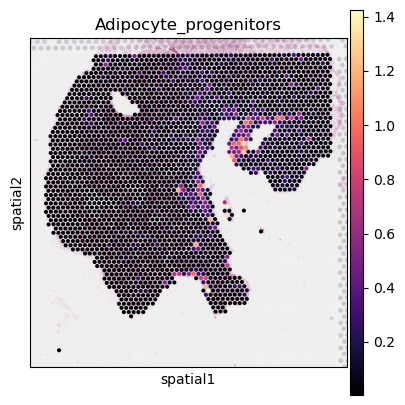

In [12]:
slide = select_slide(adata_vis, 'count-D1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'])[0], img_key='hires', size = 1.3)

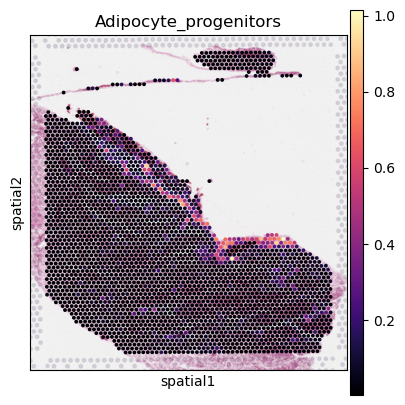

In [13]:
slide = select_slide(adata_vis, 'count-A1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'])[0], img_key='hires', size = 1.3)

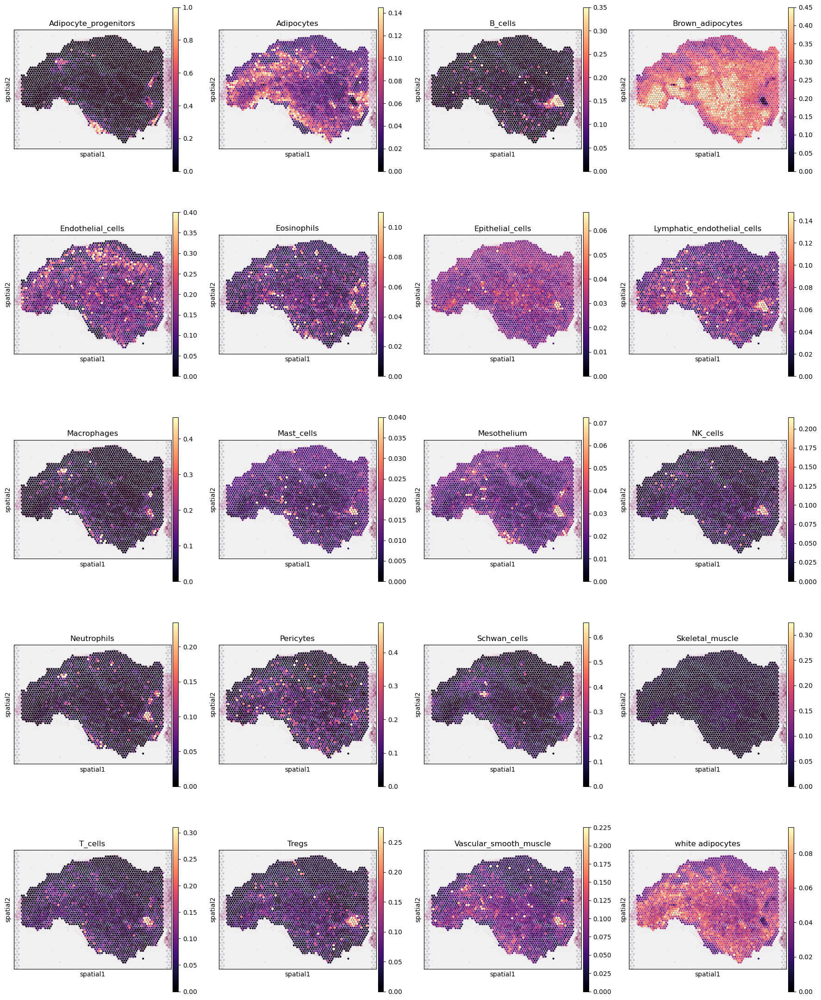

In [14]:
maxes2 = [1, 0.145, 0.35, 0.45,
         0.4, 0.11, 0.0675, 0.1475,
          0.46, 0.04, 0.0725, 0.215,
          0.235, 0.49, 0.66, 0.325,
          0.31, 0.275, 0.225, 0.095]

slide = select_slide(adata_vis, 'count-B1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=maxes2, library_id='count-B1', show = True
                 )

## why is library_id still needed after selecting the slide?

## Binary slides

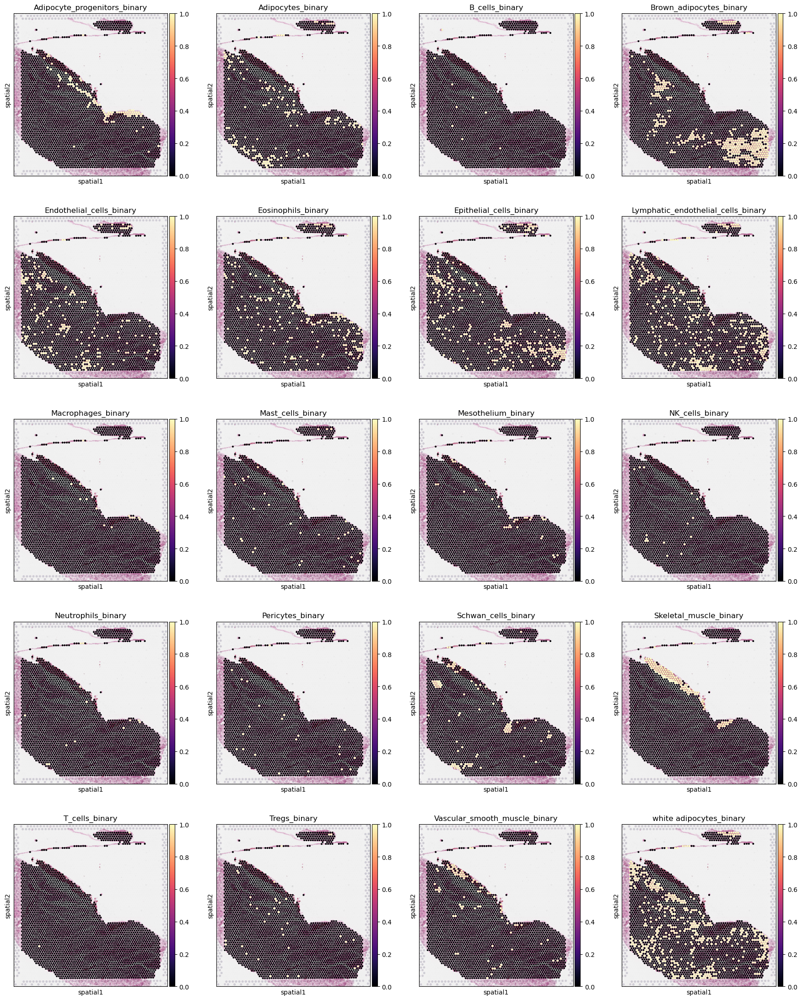

In [15]:
slide = select_slide(adata_vis, 'count-A1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-A1', show = True
                 )

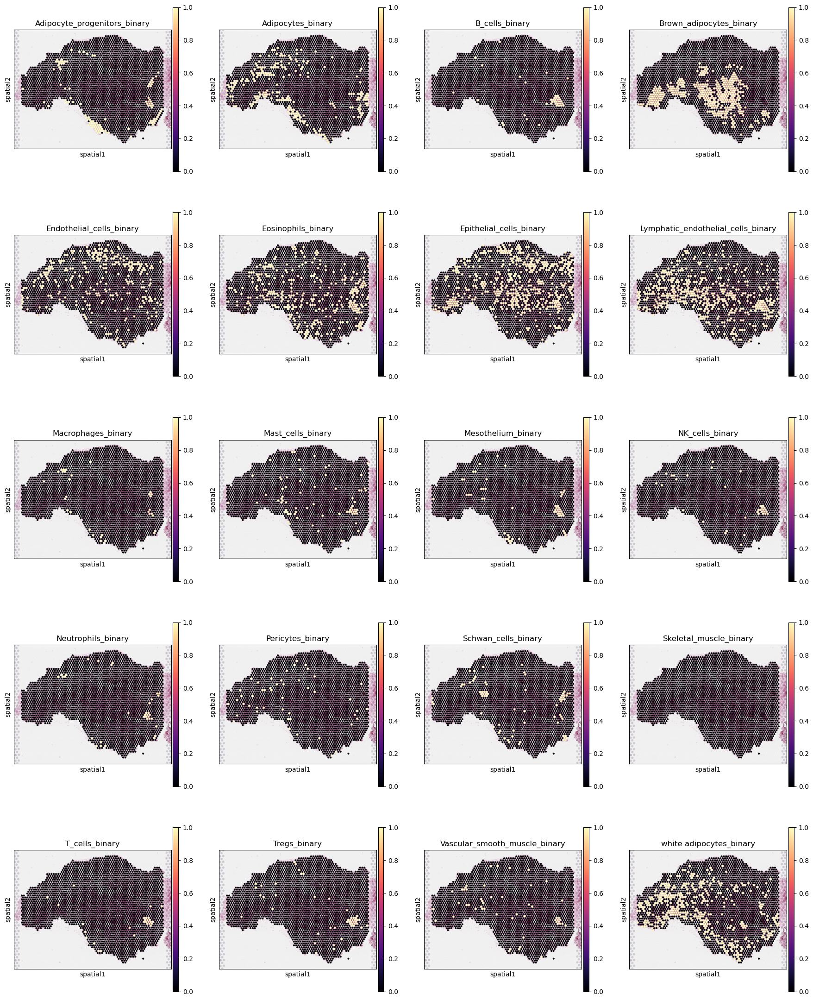

In [16]:
slide = select_slide(adata_vis, 'count-B1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-B1', show = True
                 )

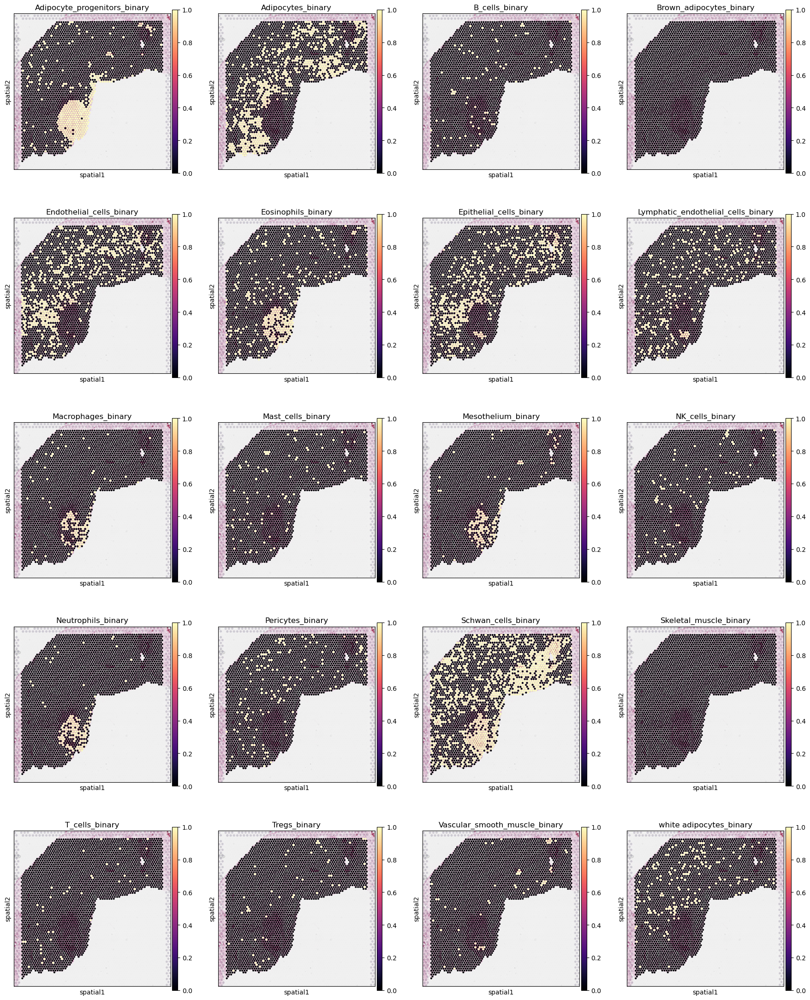

In [17]:
slide = select_slide(adata_vis, 'count-C1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-C1', show = True
                 )

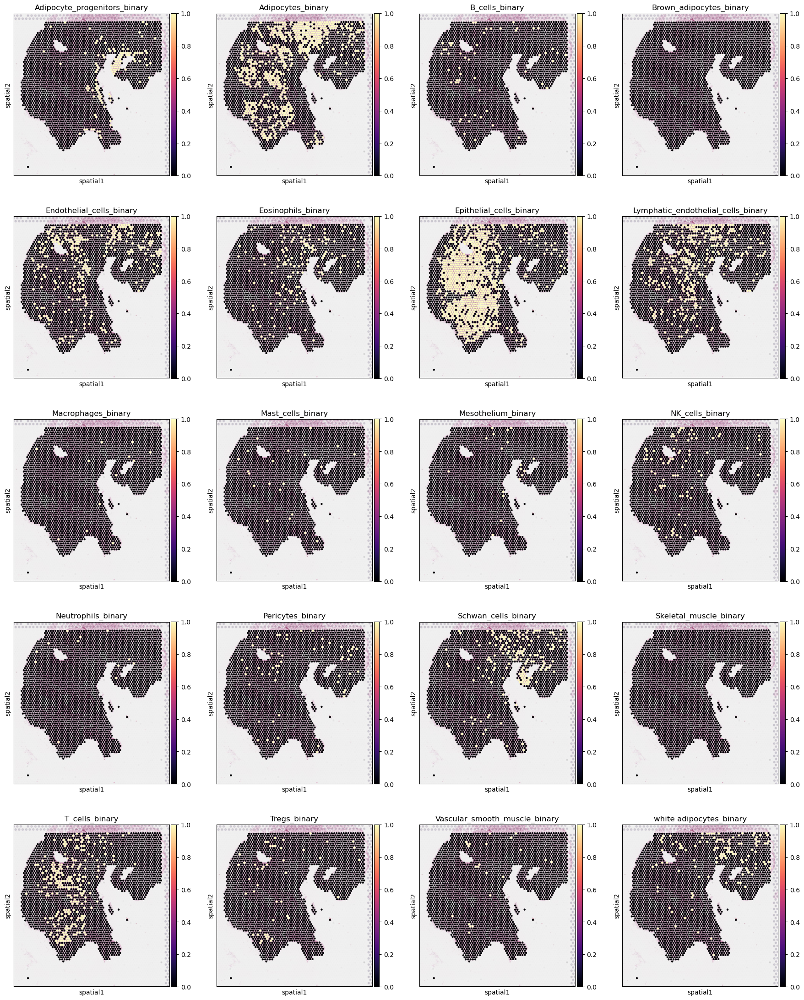

In [18]:
slide = select_slide(adata_vis, 'count-D1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-D1', show = True
                 )

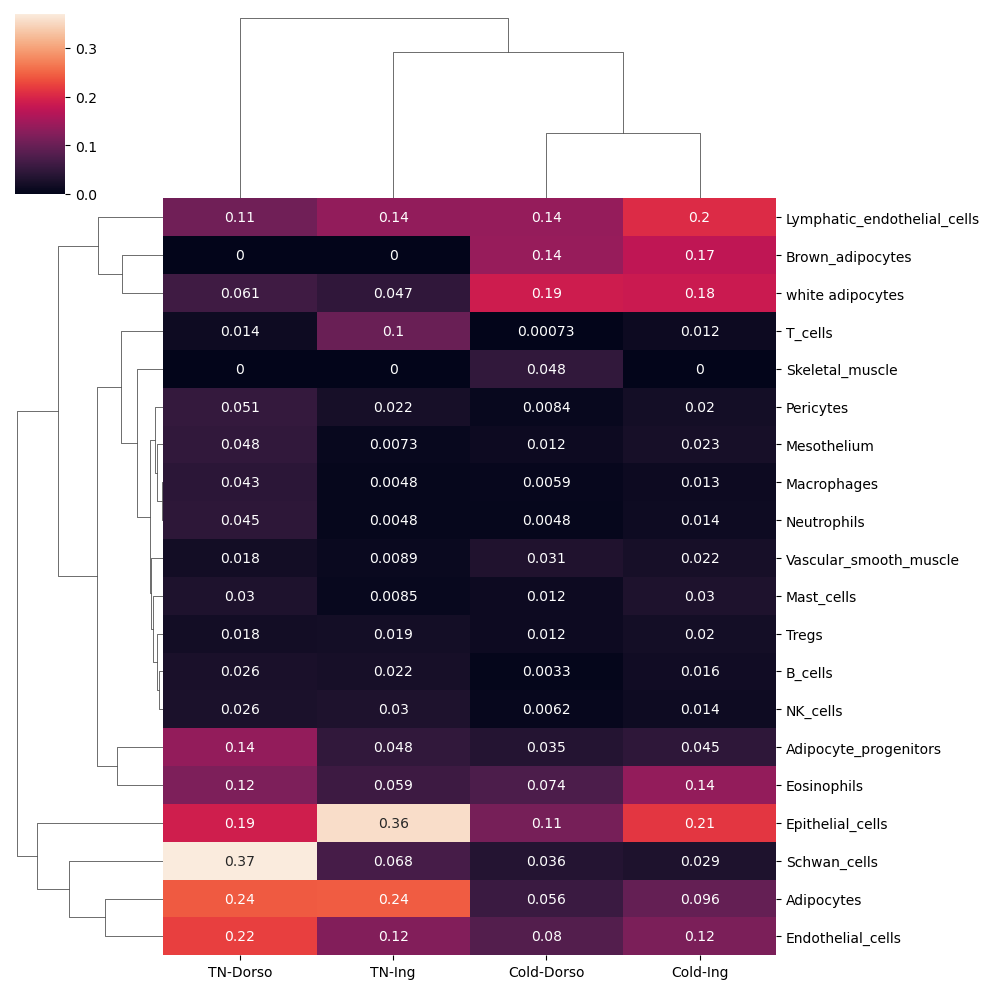

In [16]:
## make heatmap of deconvoluted_proportions_df
ax = sns.clustermap(deconvoluted_proportions_df, annot = True)

In [21]:
## cell type frequency across all slides
combined_counts = pd.concat(deconvoluted_counts.values())
combined_props = combined_counts.sum(axis = 0)/combined_counts.count(axis = 0)

In [38]:
df = pd.DataFrame(combined_props)
df.index = df.index.str.replace('q05cell_abundance_w_sf_','')

Text(0, 0.5, 'Proportion')

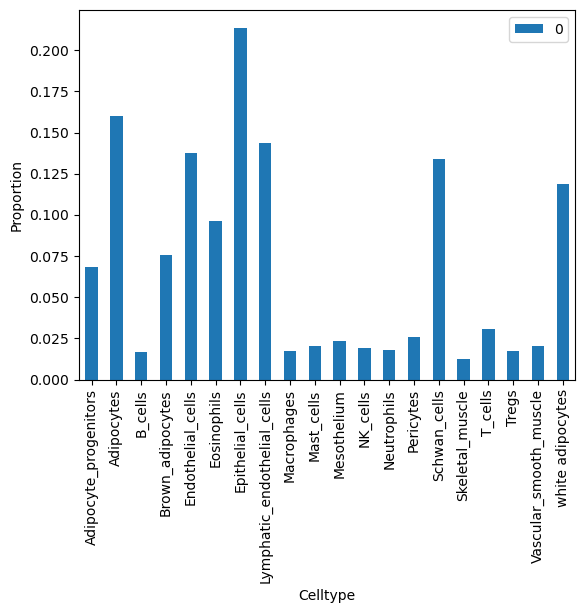

In [42]:
import matplotlib.pyplot as plt
 

# create stacked bar chart for monthly temperatures
df.plot(kind='bar', stacked=False)
 
# labels for x & y axis
plt.xlabel('Celltype')
plt.ylabel('Proportion')